# Flight Climb Digital Twin Analysis
This example demonstrates how to use KDB.ai's temporal similarity search to match aircraft sensor data back to the digital twin (simulation data) to identify areas for optimization and make informed decisions to enhance the aircraft's performance.

## What is a Digital Twin?

A digital twin is a virtual representation or replica of a physical object or system designed to mimic the behavior and characteristics of the real object in a digital environment. This digital twin is created by using data collected from sensors, devices, or other sources in the real world and it can change and adapt based on real-time information.

In the context of flight analysis, a digital twin can be used to simulate and analyze various aspects of an aircraft's performance, maintenance, and operation. We can simulate different scenarios, predict outcomes, and test changes or improvements without actually touching the real object.

<center><img src="images/Aircraft-digital-twin-concept.jpg"/></center>


## Aim

The goal is to analyse sensor readings during a specific event in time, in this example a flight taking off, and then get visibility on this event for all flights in the historical dataset.

<center><img src="images/flight_results.png"/></center>

The steps to do this are:
1. Importing Libraries 
1. Load Data
1. Data Preparation - including creation of vectors embeddings using sliding windows on numerical data
1. Create KDB.ai Index
1. Select pattern from example flight for 2 events (i)take off and (ii)top of climb
1. Search on patterns to find all historical results for (i) and (ii)
1. Merge & Analyse sensor results from (i) and (ii) 

## Importing Libraries

Start by importing the necessary libraries. We will be using the `kdbai` library to interact with KDB.ai.

In [1]:
## Uncomment this `pip install` command if you see import errors
# %pip install --quiet plotly pyarrow

In [11]:
from datetime import timedelta

import numpy as np
from numpy.lib.stride_tricks import sliding_window_view
import pandas as pd
import plotly
import plotly.express as px
from pyarrow.parquet import ParquetFile
import pyarrow as pa

# Disable Pandas warning: DataFrame is highly fragmented.
import warnings
warnings.simplefilter(action='ignore', category=pd.errors.PerformanceWarning)

plotly.offline.init_notebook_mode()

import kdbai
import pykx as kx
kx.q('\c 30 115')

pykx.Identity(pykx.q('::'))

## Load Data

Next, we will load in the data for the KDB.ai vector index using the [ParquetFile](https://arrow.apache.org/docs/python/generated/pyarrow.parquet.ParquetFile.html#pyarrow.parquet.ParquetFile.iter_batches) streaming batch function and and insert it into a dataframe.

Since the dataset could be pretty big, we'll set a limit of 10 million records to yield per batch.

- `ALT` column is important as it will become our vector embeddings, we fill in missing values 
- `aircraft` `flight` and `time` are the other key columns we will use to group our data to create embeddings. These are converted to 32-bit floating-point numbers, which can save memory compared to higher precision data types.

In [12]:
%%time

LIMIT = 1000000  # 10 Millions Max

pf = ParquetFile('/opt/kx/data/flights.parquet')
rows = next(pf.iter_batches(batch_size=LIMIT)) 
df = pa.Table.from_batches([rows]).to_pandas()
for param in [c for c in df.columns if c not in ('aircraft', 'flight', 'time')]:
    df[param] = df[param].astype('float32')
df['ALT'] = df['ALT'].fillna(value=0)
print(df.info())
df.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000000 entries, 0 to 999999
Data columns (total 68 columns):
 #   Column    Non-Null Count    Dtype         
---  ------    --------------    -----         
 0   aircraft  1000000 non-null  int64         
 1   flight    1000000 non-null  int64         
 2   time      1000000 non-null  datetime64[ns]
 3   LATP      1000000 non-null  float32       
 4   LONP      1000000 non-null  float32       
 5   PH        1000000 non-null  float32       
 6   WOW       1000000 non-null  float32       
 7   ALT       1000000 non-null  float32       
 8   MACH      1000000 non-null  float32       
 9   CAS       1000000 non-null  float32       
 10  TH        1000000 non-null  float32       
 11  ROLL      1000000 non-null  float32       
 12  PTCH      1000000 non-null  float32       
 13  DA        1000000 non-null  float32       
 14  LATG      1000000 non-null  float32       
 15  LONG      1000000 non-null  float32       
 16  VRTG      1000000 n

,aircraft,flight,time,LATP,LONP,PH,WOW,ALT,MACH,CAS,...,OIT_3,OIT_4,EGT_1,EGT_2,EGT_3,EGT_4,VIB_1,VIB_2,VIB_3,VIB_4
0,652,652200107051457,2001-07-05 14:57:00,42.210674,-83.361687,1.0,0.0,835.0,0.0,0.0,...,25.017883,26.360992,39.0,22.5,49.0,56.0,0.0,0.0,0.0,0.0
1,652,652200107051457,2001-07-05 14:57:01,42.210846,-83.361687,1.0,0.0,836.0,0.0,0.0,...,25.017883,26.360992,39.0,22.5,48.0,55.0,0.0,0.0,0.0,0.0
2,652,652200107051457,2001-07-05 14:57:02,42.210846,-83.361687,1.0,0.0,836.0,0.0,0.0,...,25.017883,26.360992,38.5,22.5,48.0,55.0,0.0,0.0,0.0,0.0
3,652,652200107051457,2001-07-05 14:57:03,42.210846,-83.361687,1.0,0.0,836.0,0.0,0.0,...,25.017883,26.360992,38.5,22.5,47.0,54.5,0.0,0.0,0.0,0.0
4,652,652200107051457,2001-07-05 14:57:04,42.210846,-83.361687,1.0,0.0,837.0,0.0,0.0,...,25.017883,26.360992,38.5,22.5,47.0,54.5,0.0,0.0,0.0,0.0


## Data Preparation

Next, we need to do some data preparation and normalization to get our data in the correct format ahead of creating the index. This includes, creating a sliding window on the number of flights and altitude levels by each aircraft-flight combination. This sliding window on altitide `vectors` will become our vector embeddings.


### Filter flights

Filters flights to keep only the flights that have a count greater than or equal to 60. This is stored in `flights_counts` as the number of records grouped per flight.

In [15]:
D = 60

flight_counts = df[['flight', 'time']].groupby('flight').count()
selected_flights = flight_counts[flight_counts['time']>=D].index.values
df = df[df['flight'].isin(selected_flights)]
print(f'{len(selected_flights)} flight recordings...')

191 flight recordings...


### Create vector embeddings

Create the vector embeddings `vectors` by applying a sliding 60 window to the altitudes grouped on each aircraft-flight combination.


In [17]:
vecdf = df.groupby(['aircraft', 'flight'])['ALT'] \
          .apply(lambda x: pd.DataFrame(dict(ALT=list(sliding_window_view(x, D))))) \
          .reset_index() \
          .drop('level_2', axis=1) \
          .set_index(['aircraft', 'flight'])
vectors = np.stack(vecdf['ALT'].values)
print(f'{len(vectors)} altitude vectors...')

988731 altitude vectors...


### Normalize and create training dataset

Perform z-score normalization to transform the vectors array into a standard scale that is better for analysis later on. 

We also handle any potential NaN values before setting up our training dataset.

In [22]:
norm = (vectors - vectors.mean(axis=1).reshape(-1, 1)) / vectors.std(axis=1).reshape(-1, 1)
norm[np.isnan(norm)] = 0

training_idx = np.random.choice(len(norm), len(norm)//100, replace=False)
training_df = pd.DataFrame(dict(vectors=list(norm[training_idx])))

/tmp/ipykernel_43/2333787225.py:1: RuntimeWarning:

invalid value encountered in divide



<div class="alert alert-block alert-warning">
<b>Getting a warning?:</b> We can ignore this RuntimeWarning "invalid value encountered in divide". It does not affect the code later on in the notebook.
</div>

## Create KDB.ai Index
Now, we are ready to build a IVFPQ index using KDB.ai with 1 million vectors extracted from the Altitude "sensor" time series using a sliding window of 60 seconds (vector dimensionality = 60).

Let's break this down and explain what the code does:

1. `index_options` are the parameters that will be for subsequent clustering or indexing operations in the next step
1. `index` is the line that creates the index using the `kdbai` library, here's what each part of the code represents:
    - `myIndex`: This specifies the name or identifier for the index
    - `ivfpq`: This is the chosen index type or algorithm, 'ivfpq' refers to the Inverted File with Product Quantization algorithm.
    - `('data', None)`: A list containing two elements (table_name;schema) where:
        - table_name is the name of the in-memory table to which data added to the vector database will be appended.
        - schema - this element will be used to contain the schema to be adhered to when appending new data to the database.
    - `vectors` is column within the database and appended data which contains the supplied vector embeddings, this column must exist in data added to the database as it is used to update the search index.
    - `options=index_options`: is the configuration settings for the index. The index_options dictionary created earlier is passed as an argument here, providing various parameters such as initData, nclusters, nsplits, and nbits.
1. `index.append` adds datapoints to the initialized vector embedding model generated

In [5]:
index_options = dict(initData=training_df, nclusters=16, nsplits=12, nbits=8)
index = kdbai.KDBAI('myIndex', 'ivfpq', ('data', None), 'vectors', options=index_options)
index.append(pd.DataFrame(dict(vectors=list(norm))))

WARNING clustering 9887 points to 256 centroids: please provide at least 9984 training points
WARNING clustering 9887 points to 256 centroids: please provide at least 9984 training points
WARNING clustering 9887 points to 256 centroids: please provide at least 9984 training points
WARNING clustering 9887 points to 256 centroids: please provide at least 9984 training points
WARNING clustering 9887 points to 256 centroids: please provide at least 9984 training points
WARNING clustering 9887 points to 256 centroids: please provide at least 9984 training points
WARNING clustering 9887 points to 256 centroids: please provide at least 9984 training points
WARNING clustering 9887 points to 256 centroids: please provide at least 9984 training points
WARNING clustering 9887 points to 256 centroids: please provide at least 9984 training points
WARNING clustering 9887 points to 256 centroids: please provide at least 9984 training points
WARNING clustering 9887 points to 256 centroids: please prov

Setting the table: '.kdbai.table.data' as a global table within this process

Updating index with new vector data
Updating in-memory table: '.kdbai.table.data' with new data


<div class="alert alert-block alert-warning">
<b>Getting a warning?:</b> We can ignore this "WARNING clustering 9887 points to 256 centroids". It does not affect the code later on in the notebook.
</div>

## Select Flight Patterns

Select pattern from an example flight for 2 events (i)take off and (ii)top of climb. These patterns will be what we search for in our historical dataset.

Start by looking at just one single flight, highlighting the (i)take off and (ii)top of climb zones - in this case flight `652200206181054`.

In [50]:
# Cherry picked flight with take off and top of climb timestamps
f = 652200206181054
take_off = pd.to_datetime('2002-06-18 11:02:10')
top_of_climb = pd.to_datetime('2002-06-18 11:07:45')

### Flight Altitude Profile

We can see for one single flight the altitude profile with the:

- (i) take off (red)
- (ii) top of climb (green)

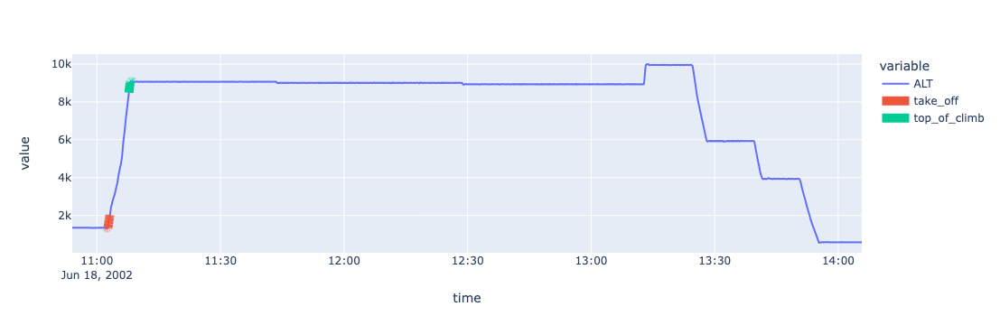

In [56]:
ff = df[df['flight']==f].set_index('time')
cond = (ff.index>=take_off)&(ff.index<take_off+timedelta(seconds=60))
ff.loc[cond, 'take_off'] = ff[cond]['ALT']
cond = (ff.index>=top_of_climb)&(ff.index<top_of_climb+timedelta(seconds=60))
ff.loc[cond, 'top_of_climb'] = ff[cond]['ALT']

fig = px.line(ff[['ALT', 'take_off', 'top_of_climb']].astype('float64'))
fig.update_traces(line_width=10, selector=dict(name='take_off'))
fig.update_traces(line_width=10, selector=dict(name='top_of_climb'))
fig.show()

### Splitting out the (i) take off and (i) top of climb patterns

For (i) take off we can zoom into the area around the red square. This will be our first pattern we search on.

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 60 entries, 2002-06-18 11:02:10 to 2002-06-18 11:03:09
Data columns (total 1 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   take_off  60 non-null     float32
dtypes: float32(1)
memory usage: 720.0 bytes
None


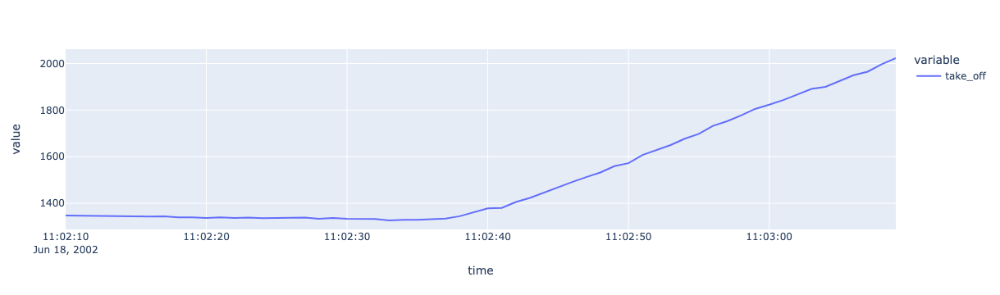

In [37]:
pattern = ff[['take_off']].dropna()
print(pattern.info())
px.line(pattern)

For (ii) top of climb we can zoom into the area around the green square. This will be our second pattern we search on.

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 60 entries, 2002-06-18 11:07:45 to 2002-06-18 11:08:44
Data columns (total 1 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   top_of_climb  60 non-null     float32
dtypes: float32(1)
memory usage: 720.0 bytes
None


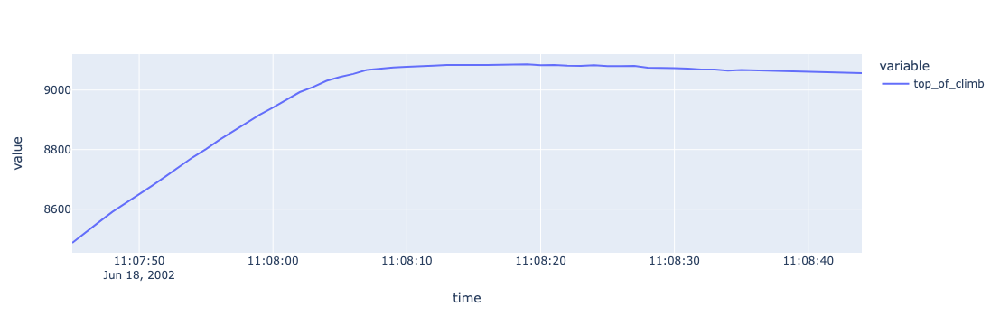

In [52]:
pattern = ff[['top_of_climb']].dropna()
print(pattern.info())
px.line(pattern)

## Search based on numerical altitude profiles

Now, we are ready to perform our search using KDB.ai, we do it seperately on our 2 patterns (i) take off and (ii) top of climb.

### Search (i) take off

- First convert the values used for `query` to desired numerical format for further computations
- Use the function `index.search` to perform our search on our dataset for take off pattern
- Retrieve the nearest neighbor indices, applying a mask to select only 3000 points, and compute the length of the resulting selected indices.

In [41]:
%%time
query = pattern['take_off'].values.astype('float32')
query = (query - query.mean()) / query.std()

to_rez = index.search(query.reshape(1, -1), verbose=2, options=dict(neighbors=K))
mask = (vectors[:,0] <= 3000)
to_idx = np.array(sorted(set(to_rez['nn_idx'].np()) & set(np.where(mask)[0])))
len(to_idx)

CPU times: user 52.7 ms, sys: 70 µs, total: 52.8 ms
Wall time: 51.1 ms


697

We find a lot of Take Offs in the historical dataset - these are the blue lines.

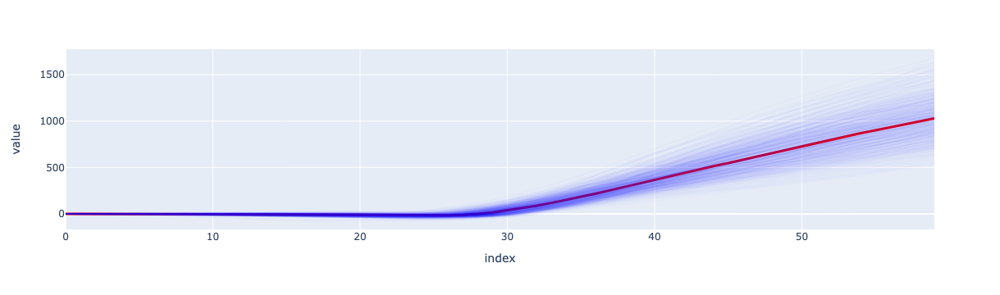

In [42]:
take_offs = pd.DataFrame(vectors[to_idx].T)
for c in take_offs.columns:
    take_offs[c] = take_offs[c] - take_offs[c].iloc[0]
fig = px.line(take_offs)
fig.update_traces(line_color='blue', opacity=0.01)
fig.add_trace(dict(y=take_offs.median(axis=1), line=dict(color='red', width=3)))
fig.update_layout(showlegend=False)
fig.show()

<div class="alert alert-block alert-info">
<b>Note:</b> Take a look at the time it took to perform the search query - impressive right? </div>

### Search (ii) top of climb

Perform the same analysis again for (ii) top of climb pattern.

In [53]:
%%time
query = pattern['top_of_climb'].values.astype('float32')
query = (query - query.mean()) / query.std()

toc_rez = index.search(query.reshape(1, -1), verbose=2, options=dict(neighbors=K))
mask = (vectors[:,0] >= 20000)
toc_idx = np.array(sorted(set(toc_rez['nn_idx'].np()) & set(np.where(mask)[0])))
len(toc_idx)

CPU times: user 60.8 ms, sys: 2.72 ms, total: 63.6 ms
Wall time: 61.9 ms


654

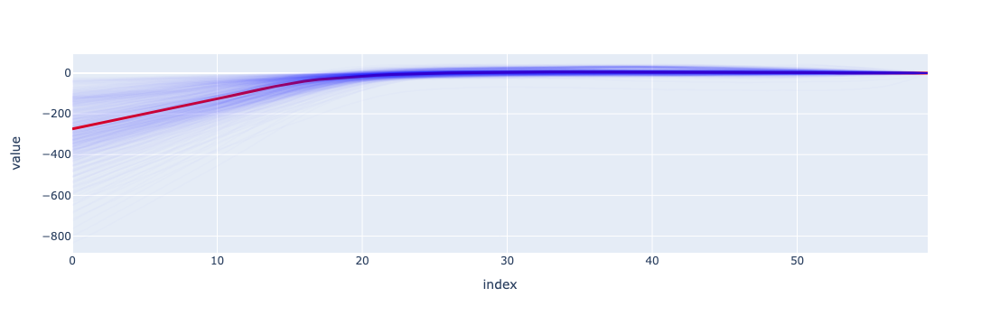

In [54]:
top_of_climbs = pd.DataFrame(vectors[toc_idx].T)
for c in top_of_climbs.columns:
    top_of_climbs[c] = top_of_climbs[c] - top_of_climbs[c].iloc[-1]
fig = px.line(top_of_climbs)
fig.update_traces(line_color='blue', opacity=0.01)
fig.add_trace(dict(y=top_of_climbs.median(axis=1), line=dict(color='red', width=3)))
fig.update_layout(showlegend=False)
fig.show()

## Merge & Analyse the results

We join both results find a list of flights with both Take Offs and Top of Climbs detected so we can analyse sensor values for both.

In [57]:
to_flights = df.iloc[to_idx]['flight'].unique()
toc_flights = df.iloc[toc_idx]['flight'].unique()
selected_flights = set(to_flights) & set(toc_flights)

Next we do various transformations and manipulations on the data to get it into format that we can use to filter the original dataset we loaded in at the beginning.


In [61]:
rezdf = tsdf.iloc[to_idx].reset_index()
rezdf['tag'] = 'takeoff'
tmpdf = tsdf.iloc[toc_idx].reset_index()
tmpdf['tag'] = 'topofclimb'
rezdf = pd.concat([rezdf, tmpdf])
rezdf['time'] = rezdf['time'].apply(lambda x: x[30])
rezdf = rezdf.pivot_table(index=['aircraft', 'flight'], columns='tag', values='time').reset_index()
rezdf = rezdf[rezdf['flight'].isin(selected_flights)].dropna().reset_index()
rezdf

tag,index,aircraft,flight,takeoff,topofclimb
0,1,652,652200101291935,2001-01-29 19:45:35.500000000,2001-01-29 20:14:17.000000128
1,6,652,652200107231433,2001-07-23 14:42:42.000000000,2001-07-23 14:56:25.000000128
2,7,652,652200107240724,2001-07-24 07:47:55.500000000,2001-07-24 08:16:54.500000000
3,9,652,652200107241356,2001-07-24 14:07:49.500000000,2001-07-24 14:20:11.500000000
4,13,652,652200109181055,2001-09-18 11:30:06.333333248,2001-09-18 12:29:26.500000128
...,...,...,...,...,...
56,157,654,654200106021537,2001-06-02 15:44:24.999999872,2001-06-02 16:12:40.500000000
57,158,654,654200106220455,2001-06-22 05:06:02.000000000,2001-06-22 05:23:40.500000128
58,159,654,654200106300932,2001-06-30 09:56:49.000000000,2001-06-30 10:16:22.999999872
59,161,654,654200107162127,2001-07-16 21:33:54.000000000,2001-07-16 21:57:19.100000000


Filter the original dataset we loaded in at the beginning for all flights within the (i) take off and (ii) top of flight zones. 

We want to use this original dataset for analysis as it has all the other sensor readings of interest - remember we only selected a few columns to perform the search.

In [62]:
dfs = []
for row in rezdf.to_dict(orient='records'):
    dfs.append(df[(df['flight']==row['flight'])&(df['time']>=row['takeoff'])&(df['time']<=row['topofclimb'])])
subdf = pd.concat(dfs)
print(subdf.info())
subdf

<class 'pandas.core.frame.DataFrame'>
Int64Index: 87735 entries, 674552 to 468651
Data columns (total 68 columns):
 #   Column    Non-Null Count  Dtype         
---  ------    --------------  -----         
 0   aircraft  87735 non-null  int64         
 1   flight    87735 non-null  int64         
 2   time      87735 non-null  datetime64[ns]
 3   LATP      87735 non-null  float32       
 4   LONP      87735 non-null  float32       
 5   PH        87735 non-null  float32       
 6   WOW       87735 non-null  float32       
 7   ALT       87735 non-null  float32       
 8   MACH      87735 non-null  float32       
 9   CAS       87735 non-null  float32       
 10  TH        87735 non-null  float32       
 11  ROLL      87735 non-null  float32       
 12  PTCH      87735 non-null  float32       
 13  DA        87735 non-null  float32       
 14  LATG      87735 non-null  float32       
 15  LONG      87735 non-null  float32       
 16  VRTG      87735 non-null  float32       
 17  IVV   

,aircraft,flight,time,LATP,LONP,PH,WOW,ALT,MACH,CAS,...,OIT_3,OIT_4,EGT_1,EGT_2,EGT_3,EGT_4,VIB_1,VIB_2,VIB_3,VIB_4
674552,652,652200101291935,2001-01-29 19:45:36,42.216858,-83.355835,3.0,1.0,668.0,0.219744,142.5625,...,77.398773,77.398773,585.0,590.5,582.5,581.5,0.21875,0.31250,0.25000,0.1875
674553,652,652200101291935,2001-01-29 19:45:37,42.216511,-83.356354,3.0,1.0,697.0,0.217791,141.2500,...,77.398773,77.398773,585.0,590.5,582.5,581.5,0.21875,0.31250,0.25000,0.1875
674554,652,652200101291935,2001-01-29 19:45:38,42.215824,-83.356689,3.0,1.0,719.0,0.221004,143.2500,...,77.398773,77.398773,585.0,590.5,583.0,581.5,0.21875,0.31250,0.28125,0.1875
674555,652,652200101291935,2001-01-29 19:45:39,42.215309,-83.357208,3.0,1.0,756.0,0.218610,141.6250,...,77.398773,77.398773,585.0,590.5,583.0,581.5,0.21875,0.31250,0.25000,0.1875
674556,652,652200101291935,2001-01-29 19:45:40,42.214622,-83.357552,4.0,1.0,784.0,0.219996,142.4375,...,77.398773,77.398773,585.0,590.5,583.0,581.5,0.21875,0.31250,0.25000,0.1875
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
468647,654,654200109201744,2001-09-20 18:26:15,42.444824,-84.869049,4.0,1.0,24028.0,0.665595,280.2500,...,86.800476,89.486694,529.0,507.0,503.0,517.5,0.21875,0.18750,0.15625,0.0625
468648,654,654200109201744,2001-09-20 18:26:16,42.444824,-84.870949,4.0,1.0,24029.0,0.666288,280.5625,...,86.800476,89.486694,525.0,503.0,498.5,513.0,0.21875,0.18750,0.15625,0.0625
468649,654,654200109201744,2001-09-20 18:26:17,42.444996,-84.873856,4.0,1.0,24027.0,0.669186,281.8750,...,86.800476,89.486694,521.5,498.5,494.5,508.0,0.21875,0.18750,0.18750,0.0625
468650,654,654200109201744,2001-09-20 18:26:18,42.444996,-84.875725,4.0,1.0,24027.0,0.669879,282.1875,...,85.457397,88.143585,517.0,495.0,490.5,505.0,0.21875,0.18750,0.18750,0.0625


### Analyse sensors on all detected climbs

Selecting the altitude and aircraft speed for all historical flights.

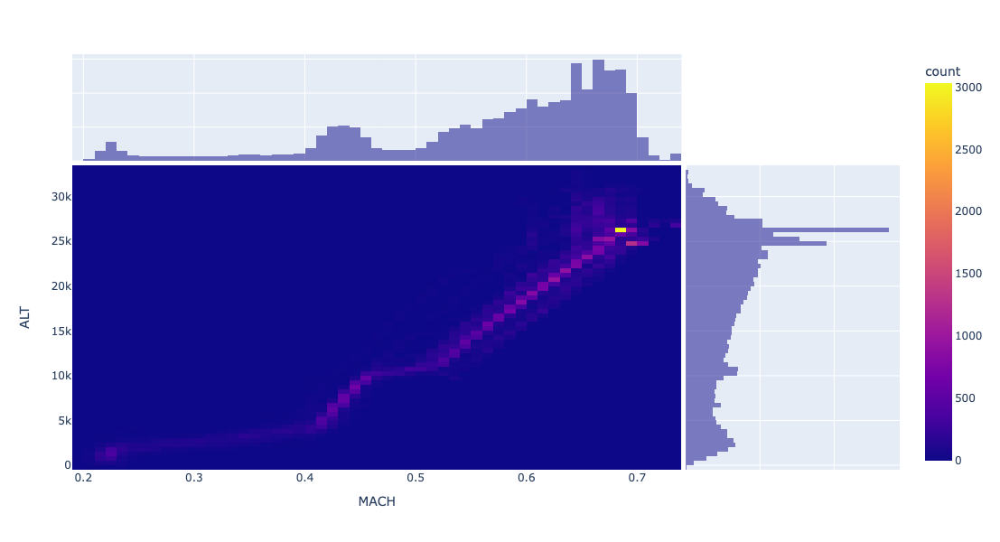

In [63]:
fig = px.density_heatmap(subdf, x='MACH', y='ALT', # color_continuous_scale='Inferno',
                         nbinsx=100, nbinsy=100, width=800, height=600,
                         marginal_x="histogram", marginal_y="histogram"
                        )
fig.show()

Selecting the static pressure (PS) and static air temperature in degrees (SAT) for all historical flights.

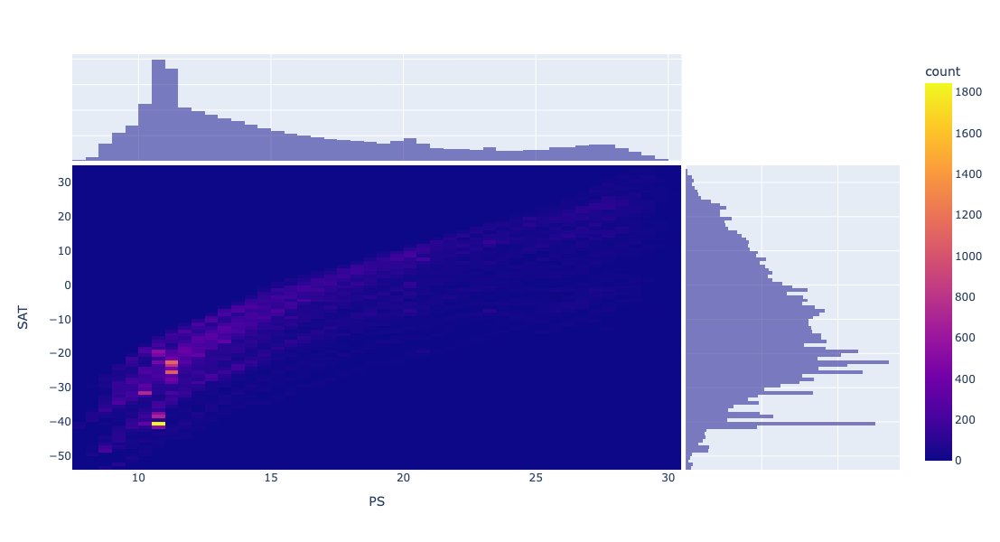

In [65]:
fig = px.density_heatmap(subdf, x='PS', y='SAT', # color_continuous_scale='Inferno',
                         nbinsx=100, nbinsy=100, width=800, height=600,
                         marginal_x="histogram", marginal_y="histogram"
                        )
fig.show()

Selecting the Fan rotation speed of engine 1 (N1_1) and fuel flow (FF_1) for all historical flights.

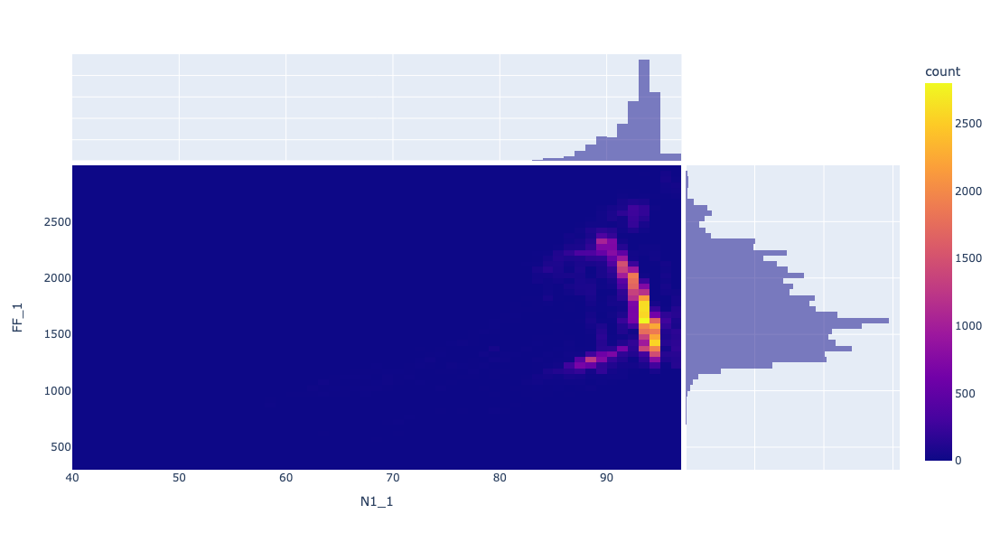

In [68]:
fig = px.density_heatmap(subdf, x='N1_1', y='FF_1', # color_continuous_scale='Inferno',
                         nbinsx=100, nbinsy=100, width=800, height=600,
                         marginal_x="histogram", marginal_y="histogram"
                        )
fig.show()

## Conclusion 

We're getting answers straight away on historical sensor readings for all flights during their climb zone - pretty great!

This dataset and findings could be then be used in a digital twin to simulate an aircraft's performance and operation.